In [1]:
from __future__ import  print_function
import time

import numpy as np
import pandas as pd

from sklearn.datasets import fetch_openml
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

import seaborn as sns


In [13]:
# this skips all the above database operations
mnist = pd.read_csv('../../data/datasets/train.csv')
mnist.rename( columns={'label' : 'y'}, inplace=True)
mnist['label'] =  mnist.iloc[:, 0].apply(lambda i: str(i))


In [9]:
# operate PCA upo tree dimesion reduction

pca = PCA(n_components=3)
pca_result = pca.fit_transform(mnist.loc[:, feat_cols].values)

mnist['pca-one'] = pca_result[:, 0]
mnist['pca-two'] = pca_result[:, 1]
mnist['pca_three'] = pca_result[:, 2]

print(f'Explained variation per principal component: {pca.explained_variance_ratio_}')


Explained variation per principal component: [0.09748938 0.07160266 0.06145903]


In [14]:
#shuffel the dataset
np.random.seed(43)
rndperm = np.random.permutation(mnist.shape[0])

feat_cols = mnist.columns[1:-1]

<Figure size 432x288 with 0 Axes>

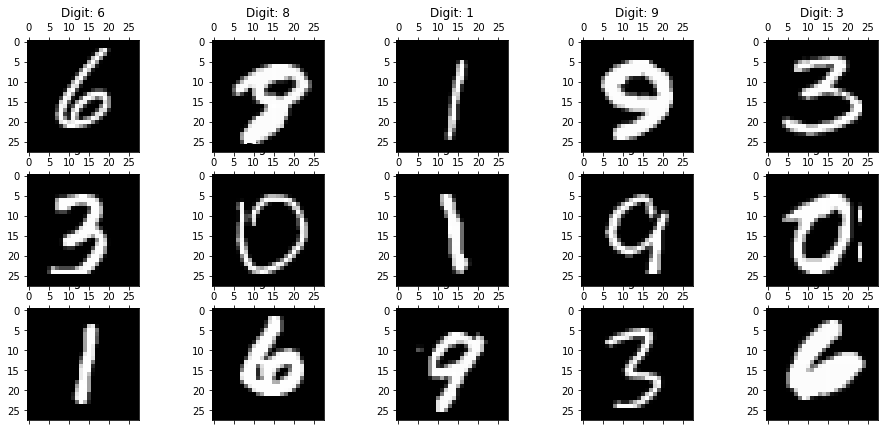

In [15]:
# plot digits
plt.gray()
fig = plt.figure( figsize=(16,7))
for i in range(15):
    ax = fig.add_subplot(3,5,i+1, title=f'Digit: {mnist.loc[rndperm[i], "label"]}')
    ax.matshow(mnist.loc[rndperm[i], feat_cols].values.reshape(28,28).astype(np.float32))
plt.show()


In [16]:
# operate PCA upo tree dimesion reduction

pca = PCA(n_components=3)
pca_result = pca.fit_transform(mnist.loc[:, feat_cols].values)

mnist['pca-one'] = pca_result[:, 0]
mnist['pca-two'] = pca_result[:, 1]
mnist['pca_three'] = pca_result[:, 2]

print(f'Explained variation per principal component: {pca.explained_variance_ratio_}')


Explained variation per principal component: [0.09748938 0.07160266 0.06145903]


<Figure size 1152x720 with 0 Axes>

<AxesSubplot:xlabel='pca-one', ylabel='pca-two'>

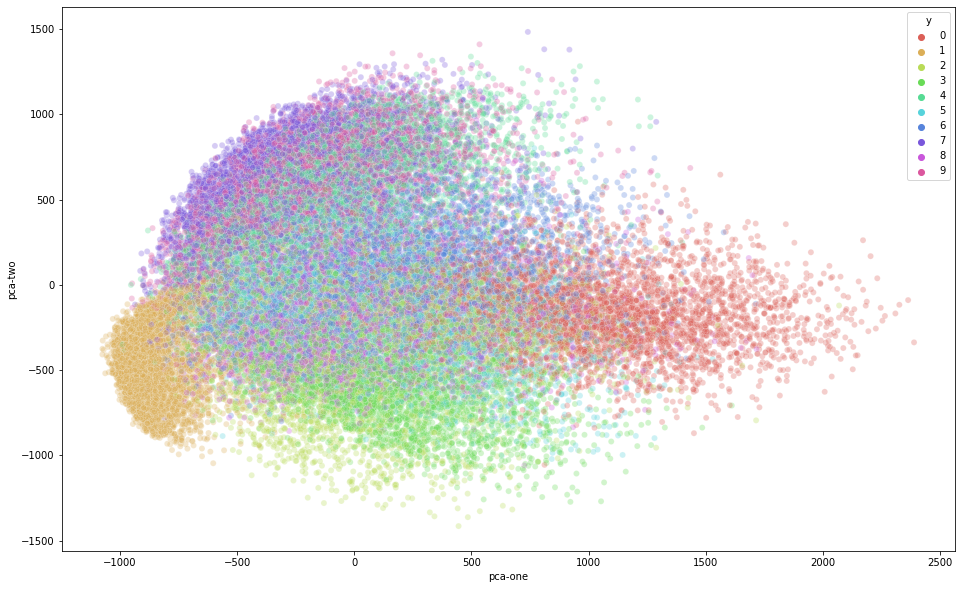

In [17]:
# graph variation pca-one with pca-two

plt.figure(figsize=(16,10))
sns.scatterplot(x="pca-one", y="pca-two",hue="y",
            palette=sns.color_palette("hls", 10),
            data=mnist.loc[rndperm, :],
            legend="full",
            alpha=0.3
)




In [19]:
# operate PCA upo tree dimesion reduction

pca = PCA(n_components=3)
pca_result = pca.fit_transform(mnist.loc[:, feat_cols].values)

mnist['pca-one'] = pca_result[:, 0]
mnist['pca-two'] = pca_result[:, 1]
mnist['pca-three'] = pca_result[:, 2]

print(f'Explained variation per principal component: {pca.explained_variance_ratio_}')


Explained variation per principal component: [0.09748938 0.07160266 0.06145903]


Text(0.5, 0, 'pca_one')

Text(0.5, 0, 'pca_two')

Text(0.5, 0, 'pca_three')

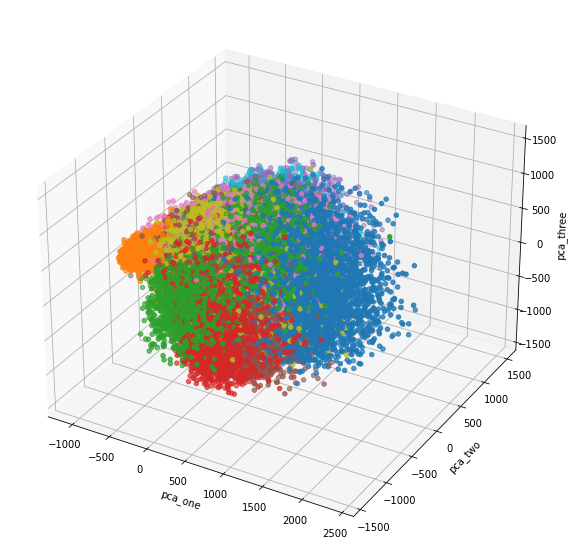

In [20]:

ax = plt.figure( figsize=(16,10)).gca(projection='3d')
ax.scatter(
    xs=mnist.loc[rndperm, :]['pca-one'],
    ys=mnist.loc[rndperm, :]['pca-two'],
    zs=mnist.loc[rndperm, :]['pca-three'],
    c=mnist.loc[rndperm, :]['y'],
    cmap='tab10'
)
ax.set_xlabel('pca_one')
ax.set_ylabel('pca_two')
ax.set_zlabel('pca_three')
plt.show()

In [22]:

N = 10000

df_subset = mnist.loc[rndperm[:N], :].copy()
data_subset = df_subset.loc[:, feat_cols].values

pca = PCA(n_components=3)
pca_result = pca.fit_transform(data_subset)

df_subset['pca-one'] = pca_result[:,0]
df_subset['pca-two'] = pca_result[:,1] 
df_subset['pca-three'] = pca_result[:,2]

print(f'Explained variation per principal component : {pca.explained_variance_ratio_}')


Explained variation per principal component : [0.09800285 0.07097365 0.06093794]


In [23]:

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_result = tsne.fit_transform(data_subset)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.017s...
[t-SNE] Computed neighbors for 10000 samples in 6.185s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional probabilities for sample 5000 / 10000
[t-SNE] Computed conditional probabilities for sample 6000 / 10000
[t-SNE] Computed conditional probabilities for sample 7000 / 10000
[t-SNE] Computed conditional probabilities for sample 8000 / 10000
[t-SNE] Computed conditional probabilities for sample 9000 / 10000
[t-SNE] Computed conditional probabilities for sample 10000 / 10000
[t-SNE] Mean sigma: 439.646147
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.399429
[t-SNE] KL divergence after 300 iterations: 2.839038
t-SNE done! Time elapse

<Figure size 1152x720 with 0 Axes>

<AxesSubplot:xlabel='tsne-2d-one', ylabel='tsne-2d-two'>

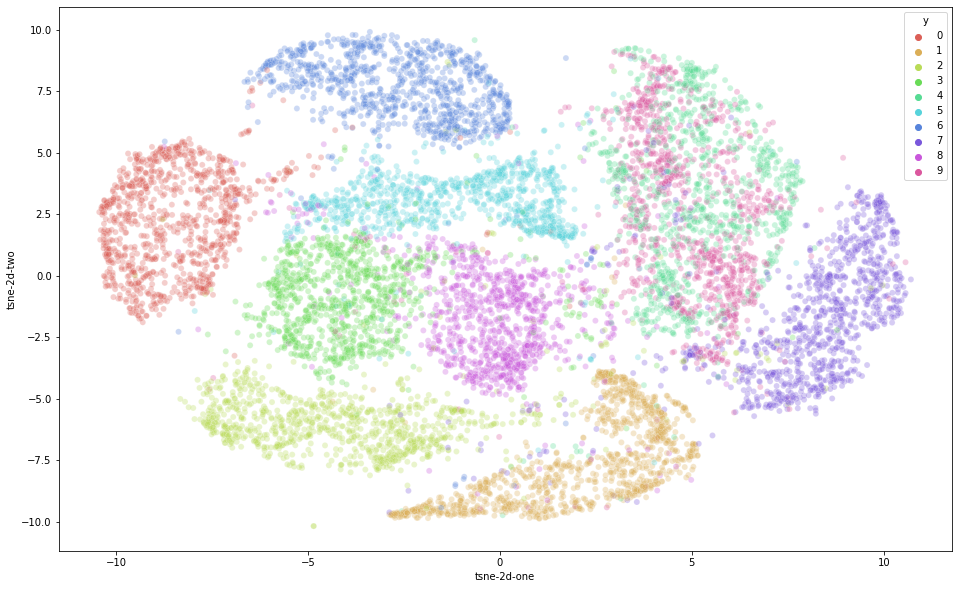

In [25]:

df_subset['tsne-2d-one'] = tsne_result[:,0]
df_subset['tsne-2d-two'] = tsne_result[:,1]
plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    hue="y",
    palette=sns.color_palette("hls", 10),
    data=df_subset,
    legend="full",
    alpha=0.3
)
